In [1]:
# Importing necessary libraries and modules for building a VGG16-based image classification model
import numpy as np                                      # Numerical computation and array handling
import tensorflow as tf                                 # TensorFlow deep learning framework
from tensorflow.keras.applications.vgg16 import VGG16    # VGG16 pre-trained model
from tensorflow.keras.models import Sequential          # Sequential model for stacking layers
from tensorflow.keras.layers import Dense, Flatten       # Layers for neural network architecture
from tensorflow.keras.preprocessing.image import ImageDataGenerator  # Image data augmentation
import matplotlib.pyplot as plt                         # Data visualization using matplotlib


In [2]:
# Set the number of classes
num_classes = 4

In [ ]:
#Description of class names


#Class a: banana fields
#Class b: grape fields
#Class c: sugarcane fields
#Class d: pathways through farm fields

In [3]:
# Define the target image size
target_size = (224, 224)

In [4]:
datagen = ImageDataGenerator(
    rescale=1.0/255.0,  # Normalize pixel values between 0 and 1
    rotation_range=20,  # Randomly rotate images within the range of 20 degrees
    width_shift_range=0.2,  # Randomly shift the width of images by 20%
    height_shift_range=0.2,  # Randomly shift the height of images by 20%
    horizontal_flip=True,  # Randomly flip images horizontally
    validation_split=0.2  # Split 20% of the data for validation
)

In [16]:
# Preprocess the training and validation images
train_generator = datagen.flow_from_directory(
    'F://experiments of 24 may//dataset june//train',
    target_size=target_size,
    batch_size=32,
    class_mode='categorical',
    subset='training'  # Specify training subset
)

Found 573 images belonging to 4 classes.


In [17]:
validation_generator = datagen.flow_from_directory(
    'F://experiments of 24 may//dataset june//train',
    target_size=target_size,
    batch_size=32,
    class_mode='categorical',
    subset='validation'  # Specify validation subset
)


Found 140 images belonging to 4 classes.


In [18]:
# Load the pre-trained VGG16 model
base_model = VGG16(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

In [19]:

# Freeze the pre-trained layers
for layer in base_model.layers:
    layer.trainable = False

In [20]:
# Create a new model and add the VGG16 base model
model = Sequential()
model.add(base_model)

In [21]:
# Flatten the output of the VGG16 base model
model.add(Flatten())

In [22]:
# Add a dense layer with 256 units
model.add(Dense(256, activation='relu'))

In [23]:
# Add the final dense layer with the number of classes
model.add(Dense(num_classes, activation='softmax'))


In [24]:
# Compile the model
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

In [25]:

# Print the model summary
model.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg16 (Functional)           (None, 7, 7, 512)         14714688  
_________________________________________________________________
flatten_1 (Flatten)          (None, 25088)             0         
_________________________________________________________________
dense_2 (Dense)              (None, 256)               6422784   
_________________________________________________________________
dense_3 (Dense)              (None, 4)                 1028      
Total params: 21,138,500
Trainable params: 6,423,812
Non-trainable params: 14,714,688
_________________________________________________________________


In [26]:
# Train the model
history = model.fit(train_generator, epochs=10, validation_data=validation_generator)

Epoch 1/10
18/18 [==============================] - 64s 4s/step - loss: 2.2580 - accuracy: 0.6073 - val_loss: 0.9059 - val_accuracy: 0.7143
Epoch 2/10
18/18 [==============================] - 51s 3s/step - loss: 0.2275 - accuracy: 0.9389 - val_loss: 0.1370 - val_accuracy: 0.9571
Epoch 3/10
18/18 [==============================] - 53s 3s/step - loss: 0.1255 - accuracy: 0.9721 - val_loss: 0.0831 - val_accuracy: 0.9643
Epoch 4/10
18/18 [==============================] - 51s 3s/step - loss: 0.0686 - accuracy: 0.9843 - val_loss: 0.0618 - val_accuracy: 0.9786
Epoch 5/10
18/18 [==============================] - 47s 3s/step - loss: 0.0585 - accuracy: 0.9878 - val_loss: 0.0401 - val_accuracy: 0.9857
Epoch 6/10
18/18 [==============================] - 49s 3s/step - loss: 0.0339 - accuracy: 0.9895 - val_loss: 0.0868 - val_accuracy: 0.9571
Epoch 7/10
18/18 [==============================] - 50s 3s/step - loss: 0.0314 - accuracy: 0.9913 - val_loss: 0.0403 - val_accuracy: 0.9857
Epoch 8/10
18/18 [==

In [28]:
import matplotlib.pyplot as plt

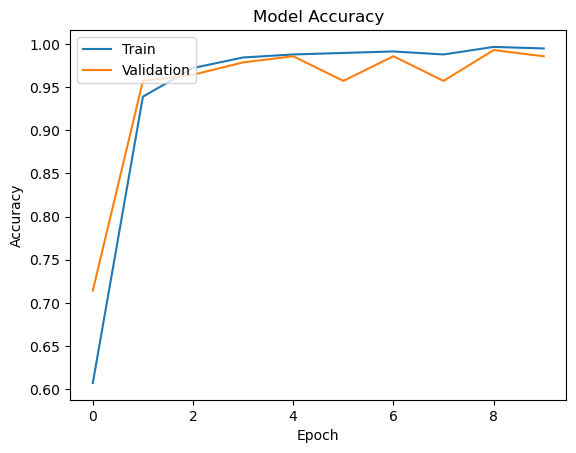

In [29]:
# Plot accuracy vs. epoch
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()

In [30]:
# Evaluate the model on the test set
test_datagen = ImageDataGenerator(rescale=1.0/255.0)
test_generator = test_datagen.flow_from_directory(
    'F://experiments of 24 may//dataset 67//dataset 2//test',
    target_size=target_size,
    batch_size=32,
    class_mode='categorical',
    shuffle=False
)

Found 38 images belonging to 4 classes.


In [31]:
loss, accuracy = model.evaluate(test_generator)
print('Test loss:', loss)
print('Test accuracy:', accuracy)

2/2 [==============================] - 4s 2s/step - loss: 0.0174 - accuracy: 1.0000
Test loss: 0.01744544878602028
Test accuracy: 1.0


In [32]:
# Get the true labels
true_labels = test_generator.classes

In [33]:
# Make predictions on the test images
predictions = model.predict(test_generator)
predicted_labels = np.argmax(predictions, axis=1)

In [35]:
from sklearn.metrics import confusion_matrix

In [36]:
# Compute confusion matrix
cm = confusion_matrix(true_labels, predicted_labels)

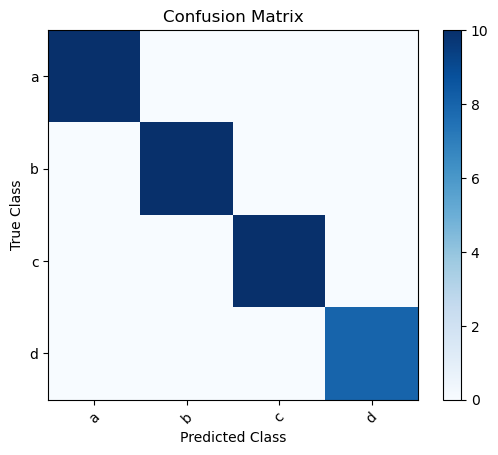

In [37]:
# Plot confusion matrix
plt.imshow(cm, interpolation='nearest', cmap=plt.cm.Blues)
plt.title('Confusion Matrix')
plt.colorbar()
tick_marks = np.arange(num_classes)
plt.xticks(tick_marks, train_generator.class_indices, rotation=45)
plt.yticks(tick_marks, train_generator.class_indices)
plt.xlabel('Predicted Class')
plt.ylabel('True Class')
plt.show()

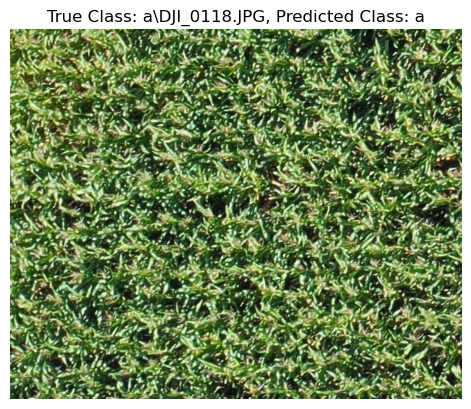

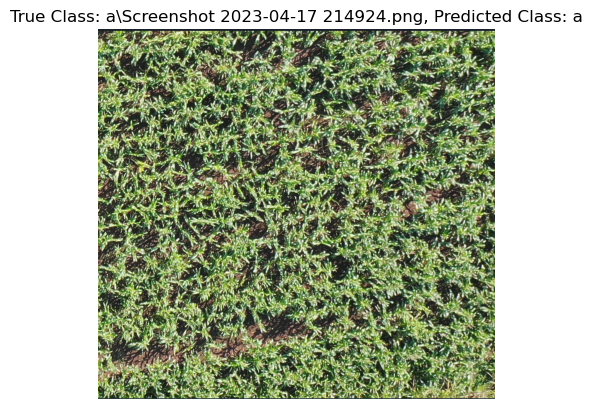

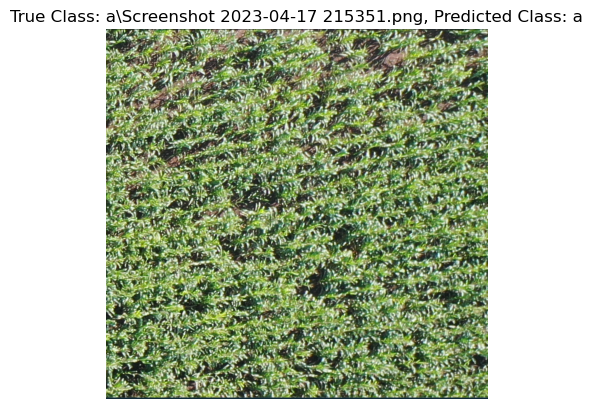

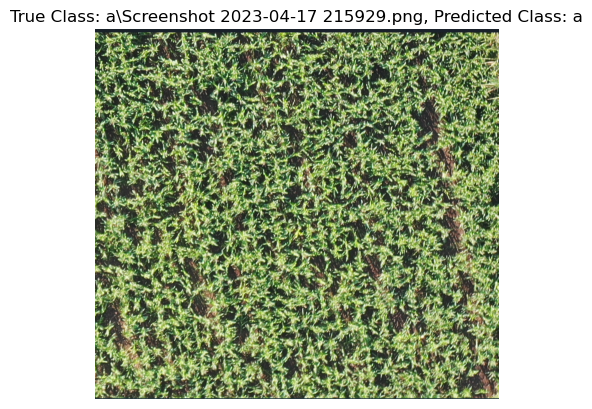

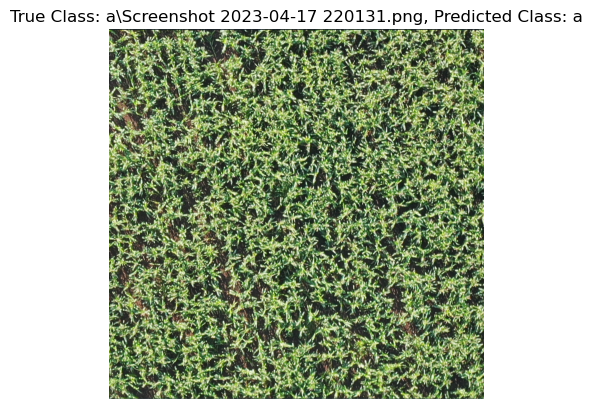

...

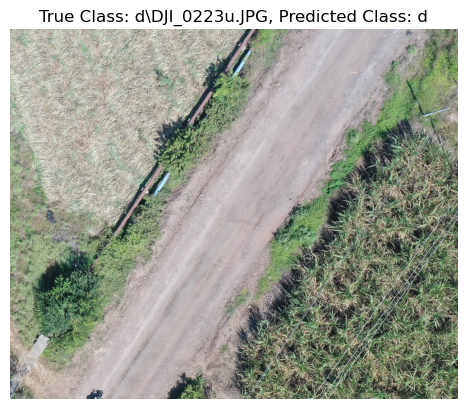

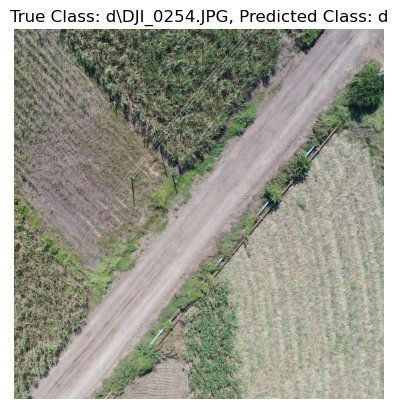

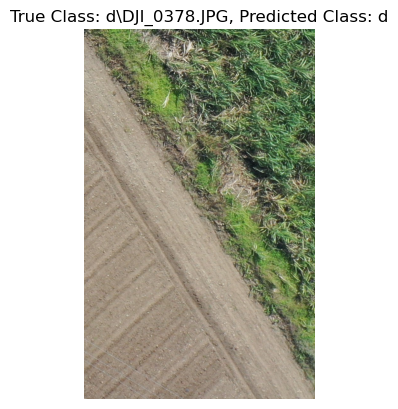

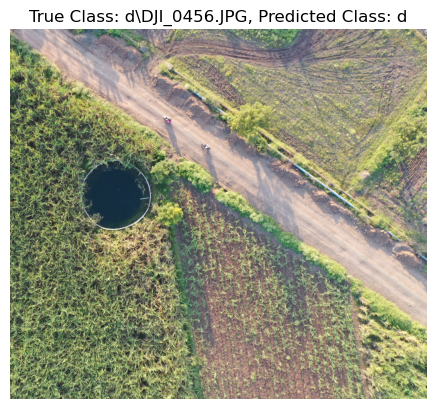

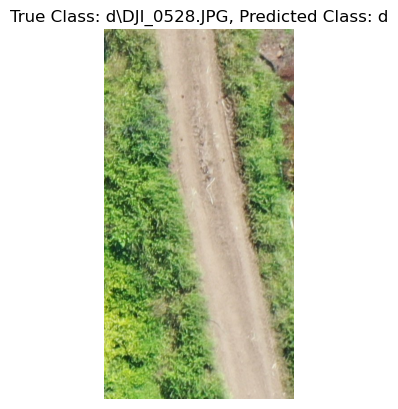

In [38]:
# Display the images with true and predicted classes
for i in range(len(test_generator.filenames)):
    image = plt.imread('F://experiments of 24 may//dataset 67//dataset 2//test/' + test_generator.filenames[i])
    true_class = test_generator.filenames[i].split('/')[0]
    predicted_class = list(train_generator.class_indices.keys())[predicted_labels[i]]

    plt.imshow(image)
    plt.title(f'True Class: {true_class}, Predicted Class: {predicted_class}')
    plt.axis('off')
    plt.show()